# Градиентный спуск
### Функции одной и двух переменных 

In [63]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [64]:
#векторная запись точки
x = np.array([-5, 5])

In [65]:
#функция одной переменной
def f(x):
    return 3*x**2

def df(x):
    return 6*x

In [66]:
x0 = 5
lam = 0.1
result = []

In [67]:
while True:
    result.append((x0, f(x0)))
    x1 = x0 - lam * df(x0)
    norm = (x0 ** 2 + x1 ** 2) ** 0.5
    if norm > 0.00000001:
        x0 = x1
    else:
        break

In [68]:
result

[(5, 75),
 (2.0, 12.0),
 (0.7999999999999998, 1.919999999999999),
 (0.3199999999999999, 0.3071999999999998),
 (0.12799999999999995, 0.04915199999999996),
 (0.05119999999999997, 0.00786431999999999),
 (0.020479999999999984, 0.001258291199999998),
 (0.008191999999999993, 0.00020132659199999963),
 (0.0032767999999999964, 3.221225471999993e-05),
 (0.0013107199999999983, 5.153960755199986e-06),
 (0.0005242879999999992, 8.246337208319973e-07),
 (0.0002097151999999996, 1.319413953331195e-07),
 (8.388607999999985e-05, 2.111062325329912e-08),
 (3.355443199999993e-05, 3.3776997205278583e-09),
 (1.3421772799999973e-05, 5.404319552844574e-10),
 (5.368709119999989e-06, 8.646911284551317e-11),
 (2.147483647999996e-06, 1.3835058055282112e-11),
 (8.589934591999983e-07, 2.2136092888451373e-12),
 (3.4359738367999934e-07, 3.54177486215222e-13),
 (1.374389534719997e-07, 5.666839779443549e-14),
 (5.4975581388799866e-08, 9.066943647109674e-15),
 (2.1990232555519943e-08, 1.4507109835375474e-15),
 (8.79609302

In [69]:
df = pd.DataFrame(result, columns=['x', 'y'])
df

,x,y
0,5.000000e+00,7.500000e+01
1,2.000000e+00,1.200000e+01
2,8.000000e-01,1.920000e+00
3,3.200000e-01,3.072000e-01
4,1.280000e-01,4.915200e-02
5,5.120000e-02,7.864320e-03
6,2.048000e-02,1.258291e-03
7,8.192000e-03,2.013266e-04
8,3.276800e-03,3.221225e-05
9,1.310720e-03,5.153961e-06


<AxesSubplot:xlabel='x'>

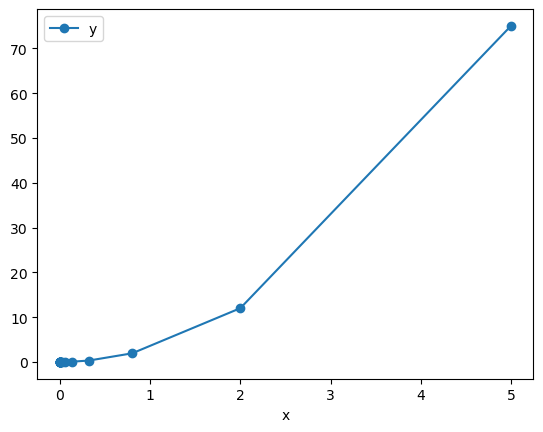

In [70]:
df.plot(x='x', 
        y='y',
        style='-o')

In [71]:
#функция двух переменных
def f(x, y):
    return 3 * np.square(x) + 5 * np.square(y)

def df(x, y):
    return np.array([6*x, 10 * y])

In [72]:
x0 = 5
y0 = 10
lam = 0.1
t = 1e-8

result1 = [(x0, y0)]

In [73]:
while True:
    x_next, y_next = (x0 - lam * df(x0, y0)[0], y0 - lam * df(x0, y0)[1])
    if (x_next - x0) ** 2 + (y_next - y0) ** 2 < t ** 2:
        break
    x0, y0 = x_next, y_next
    result1.append((x0, y0))

In [74]:
df1 = pd.DataFrame(result1, columns=['x', 'y'])
df1

,x,y
0,5.000000e+00,10.0
1,2.000000e+00,0.0
2,8.000000e-01,0.0
3,3.200000e-01,0.0
4,1.280000e-01,0.0
5,5.120000e-02,0.0
6,2.048000e-02,0.0
7,8.192000e-03,0.0
8,3.276800e-03,0.0
9,1.310720e-03,0.0


<AxesSubplot:xlabel='x'>

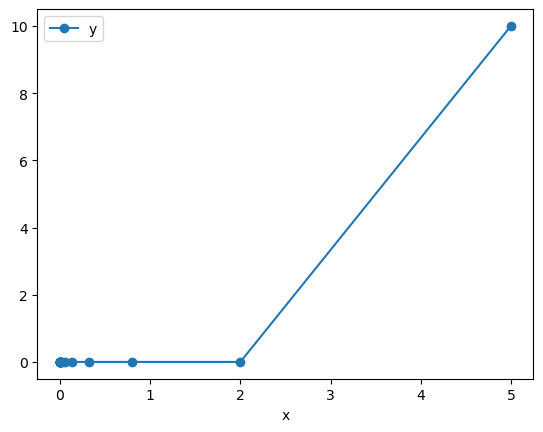

In [75]:
df1.plot(x='x', y='y', style='-o')

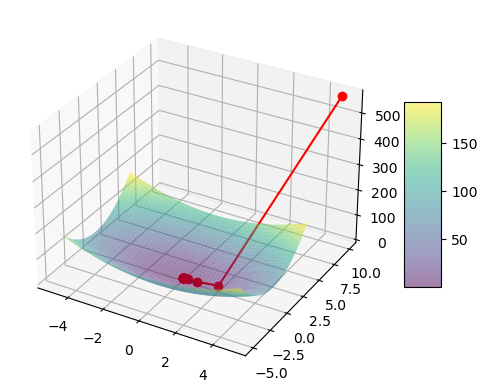

In [76]:
x = np.linspace(-5, 5, 400)
y = np.linspace(-5, 5, 400)
x, y = np.meshgrid(x, y)
z = f(x, y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

surf = ax.plot_surface(x, y, z, cmap='viridis', alpha=0.5)

result1 = np.array(result1)
z_points = f(result1[:, 0], result1[:, 1])
ax.plot(result1[:, 0], result1[:, 1], z_points, 'r-', marker='o')

fig.colorbar(surf, shrink=0.5, aspect=5)

plt.show()

In [77]:
#реализация с помощью плотли ради интереса
import plotly.graph_objects as go

x = np.linspace(-5, 5, 400)
y = np.linspace(-5, 5, 400)
x, y = np.meshgrid(x, y)
z = f(x, y)

fig = go.Figure(data=[go.Surface(z=z, x=x, y=y, colorscale='Viridis')])

result1 = np.array(result1)

z_points = f(result1[:, 0], result1[:, 1])
fig.add_trace(go.Scatter3d(x=result1[:, 0], y=result1[:, 1], z=z_points, mode='lines+markers', 
                           marker=dict(size=5, color='red')))

fig.show()